<a href="https://colab.research.google.com/github/kfukutom/cmplxsys335/blob/main/kfukutom_midterm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# REQUIRES: Packages are Installed
import networkx as nx
from numpy import zeros, ones, array
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
#Q1 : Centrality in a network of phone calls

#(a)
G = nx.read_adjlist("calls.txt", nodetype=int, create_using=nx.DiGraph())
N = G.number_of_nodes() # Number of Nodes
M = G.number_of_edges() # Number of Edges
print(f"Nodes: {N} nodes\nEdges: {M} edges")

Nodes: 536 nodes
Edges: 924 edges


In [ ]:
#(b)
ALPHA = 0.85 # Global Alpha Variable

x = ones(N, float)
for r in range(20):
  xp = zeros(N, float)
  for i in G:
    xsum = 0.0
    for j in G.predecessors(i):
      xsum += x[j] / G.out_degree(j)
    xp[i] = (ALPHA * xsum) + 1

  x = xp

# Above is the code for some non-normalized page-rank calculation metric.
# -- Code provided above is the framework for the calculation.

In [ ]:
#(c)

results = [(node, x[node]) for node in G]
results.sort(key=lambda x: x[1], reverse=True)

# Local T3-Variable
t3 = results[:3]
for node, rank in t3:
  print(f"Node {node}: {rank:.5f}")
print(f"Above are the top-3 values categorized within the PageRank calculation metric using alpha: {ALPHA}")

Node 289: 22.69136
Node 138: 20.98882
Node 439: 19.12546
Above are the top-3 values categorized within the PageRank calculation metric using alpha: 0.85


In [ ]:
#(d)
# ADDITIONAL LAYOUT PACKAGE
from networkx.drawing.nx_pydot import pydot_layout

# Option 1 - Default pydot_layout()
plt.figure(figsize=(110, 120)) # instantiate fig-size
SIZES = [1800 * x[node] for node in G.nodes()] # Variable for node-size, node-color
p = pydot_layout(G) # Layout for G
nx.draw(G, node_size=SIZES, node_color=SIZES, pos=p, with_labels=True)
plt.title("Network Visualization with its PageRank Proportional Nodes", size=120)
plt.axis('off')
plt.show()

In [ ]:
# Option 2 - spring_layout
plt.figure(figsize=(110, 120)) # instantiate fig-size
SIZES = [1800 * x[node] for node in G.nodes()] # Variable for node-size, node-color
p = nx.spring_layout(G, k=0.18, iterations=55) # Layout for G
nx.draw(G, node_size=SIZES, node_color=SIZES, pos=p, with_labels=True)
plt.title("Network Visualization with its PageRank Proportional Nodes", size=120)
plt.axis('off')
plt.show()

In [ ]:
#Q2 : Ranking of Soccer Teams

#(a)
# Initiate base directed network
G = nx.DiGraph()
with open("soccer.txt", "r") as file:
  for line in file:
    i, j, status = line.strip().split()

    # Case 1: Win
    if status == "win":
      if G.has_edge(i, j):
        G[i][j]['weight'] += 1
      else:
        # Else-Case, Initiate the Edge
        G.add_edge(i, j, weight=1)

    elif status == "tie":
      if G.has_edge(i, j):
        G[i][j]['weight'] += 0.5
      else:
        G.add_edge(i, j, weight=0.5)

      if G.has_edge(j, i):
        G[j][i]['weight'] += 0.5
      else:
        G.add_edge(j, i, weight=0.5)

N = G.number_of_nodes()
M = G.number_of_edges()

In [ ]:
#(b)
# ~ Bradley-Terry Model
pi = ones(N, float)
index = {node: i for i, node in enumerate(G.nodes())}

for r in range(20):
    xp = zeros(N, float)

    for i in G:
        num, denom = 0.0, 0.0

        for j in G.successors(i):
            weight_ij = G[i][j]['weight'] # win weight edge from i -> j
            num += weight_ij * pi[index[j]] / (pi[index[i]] + pi[index[j]])

        for j in G.predecessors(i):
            weight_ji = G[j][i]['weight']  # j -> i vice versa
            denom += weight_ji / (pi[index[i]] + pi[index[j]])

        xp[index[i]] = ((1 / (pi[index[i]] + 1)) + num) / ((1 / (pi[index[i]] + 1)) + denom)

    pi = xp

#(c)
strengths = {team: pi[index[team]] for team in G.nodes()}
t3 = sorted(strengths.items(), key=lambda x: x[1], reverse=True)[:3]
print("Top-3 Teams in Bradley-Terry Method Strength\n")
for item in t3:
  team = item[0]
  score = item[1]
  print(f"Team {team}: {score}")

Top-3 Teams in Bradley-Terry Method Strength

Team Brazil: 12.803159431072647
Team Belgium: 8.878007665987294
Team France: 7.240562079397141


In [ ]:
#Q3 : Neural Network of the Fruit-Fly

#(a)
G = nx.read_adjlist("flybrain.txt", nodetype=int, create_using=nx.DiGraph())
N = G.number_of_nodes()
M = G.number_of_edges()
print(f"{N} nodes & {M} edges in `flybrain.txt` network.")

134184 nodes & 2700633 edges in `flybrain.txt` network.


In [ ]:
#(b)
import random
from collections import deque

# Create a BFS-Function to Call On
def bfs(inputGraph, start_node):
    node_list = list(inputGraph.nodes())
    node_index = {node: i for i, node in enumerate(node_list)}
    N = len(node_list)

    distances = [-1] * N
    distances[node_index[start_node]] = 0
    queue = deque([start_node])
    total_distance = 0
    reachable = 0

    while queue:
        curr = queue.popleft()
        curr_idx = node_index[curr]  # index mapping, important
        d = distances[curr_idx]

        for neighbor in inputGraph.neighbors(curr):
            neighbor_idx = node_index[neighbor]
            if (distances[neighbor_idx] == -1):
                distances[neighbor_idx] = d + 1
                total_distance += distances[neighbor_idx]
                reachable += 1
                queue.append(neighbor)

    if reachable > 0:
      return total_distance / reachable
    else: return 0

random_node = random.choice(list(G.nodes))
distance = bfs(G, random_node)
print(f"Average Distance of Node {random_node}: {distance}")

Average Distance of Node 5647: 4.5914809590973205


In [ ]:
#(c) ~ Iterations of 4 to 5
ITER = 5
for i in range(ITER):
  random_node = random.choice(list(G.nodes))
  distance = bfs(G, random_node)
  print(f"Average Distance of Node {random_node}: {distance}")

Average Distance of Node 73109: 4.635688091879912
Average Distance of Node 82288: 4.834116461817449
Average Distance of Node 29337: 3.8536288535160184
Average Distance of Node 117485: 4.424170864396534
Average Distance of Node 44922: 4.226379206125327


In [ ]:
#(d)
ITER = 100
average = 0
for i in range(ITER):
  random_node = random.choice(list(G.nodes))
  distance = bfs(G, random_node)
  average += distance

calculated_average = average / ITER
print(f"The final average shortest distance of randomly chosen node(s): {calculated_average}.")

The final average shortest distance of randomly chosen node(s): 4.287479517481209.


In [ ]:
#(e) ~ Extra Credit
ITER = 100
average = []
for i in range(ITER):
  random_node = random.choice(list(G.nodes))
  distance = bfs(G, random_node)
  average.append(distance)

calculated_average = np.mean(average)
std_distance = np.std(average, ddof=1) #ddof 1 for sample variance, not population
standard_error = std_distance / np.sqrt(ITER)
print(f"The standard error: {standard_error}.")

The standard error: 0.11845626336905077.


**Part (f):**


---


Inferences and conclusions. So based on this result, I've inferred that the average distance of neural transmission in this provided network was around 4 connections. What this presumably implies to us, the audience, is that Milgram's small-world effect's premise does apply to the neural network of a fruitfly, signifying its ability to quickly transmit information, data, perceptioanl vision to/from the brain and beyond. This also tells me that there could be specialized ways for the brain of this insect to enable signalized processing from local clusters of the brain to further distant positions based on the sampling of around 100 random iterations, initialized from some random starting node. What this significance of the result and Milgram's experiment holds for this fly's brain is that by being able to prove this neural structure of the insect, the network structure implies that the fruitfly is able to maintain a robust neural network, by balancing distant and global communication with localized specialization in its brain, which is ultimately the key underlying premise to its complex functionality.

In [ ]:
#Q4 : Centrality and the Friendship Paradox

#(a)
G = nx.read_adjlist('highschool.txt', nodetype=int)
ev_centrality = nx.eigenvector_centrality(G) # NetworkX Eigen-Vector Centrality
degrees = dict(G.degree())


# (b)
x_i = array([ev_centrality[node] for node in G.nodes()])
k_i = array([degrees[node] for node in G.nodes()])

x_mean = np.mean(x_i)
k_mean = np.mean(k_i)
xk_mean = np.mean(x_i * k_i)

covariance_factor = xk_mean - (x_mean * k_mean)
print(f"The covariance between degree and eigenvector centrality: {covariance_factor}")

The covariance between degree and eigenvector centrality: 0.19936640703720843


**Part (c):**


---


The key idea of this friendship paradox is that "your friends are more central than you". Building on from this premise, the provided covariance factor between the degrree and eigenvector centrality of the nodes tells us that nodes with higher degrees tend to have higher eigenvector centrality measures. From a purely intuitive standpoint, this inferrence makes absolute sense, as a higher degree of connections would likely lead to one to be more `central`, in the network, not only because they are connected directly to other nodes but they're more likely to be connected to those with higher centrality. The way in which this translates to the friendship paradox once again, is that the positive covariance between eigenvector centrality and degree implies that individuals with a high degree are also likely connected to other nodes with some higher eigenvector centrality. Thus, the generalized friendship paradox rule withstands, as we tend to befriend more "people" who are likely to possess some sort of higher social status in a given network, where well-connected nodes are not the entirety of the matter, but nodes with more influence, centrality ultimately aligns to this general paradox's rule.

In [143]:
#Q5 : Robustness of the Internet

#(a)
G = nx.read_adjlist("internet.txt", nodetype=int)
N = G.number_of_nodes()
M = G.number_of_edges()

#(b)
def random_remove(G, p=0.75):
  G_2 = G.copy()
  for node in list(G_2.nodes()):
    if random.random() < p:
      G_2.remove_node(node)
  return G_2 # Copy would be removed.

In [144]:
#(c)
def bfs_component(G):
    rankings = []
    N = G.number_of_nodes()
    components = {}
    index = 0

    for node in G.nodes():
        if node not in components:
            queue = deque([node])
            components[node] = index
            node_k = 0

            while queue:
                curr = queue.popleft()
                node_k += 1

                for neighbor in G.neighbors(curr):
                    if neighbor not in components:
                        components[neighbor] = index
                        queue.append(neighbor)

            rankings.append(node_k)
            index += 1

    rankings_new = sorted(rankings, reverse=True)
    max1 = rankings_new[0] if rankings_new else 0

    return max1

# fraction calculation
def fraction_component(G):
  total_nodes = G.number_of_nodes()
  if total_nodes == 0:
    return 0
  else:
    largest_component = bfs_component(G)
    return (largest_component / total_nodes)

In [155]:
#(d)
G_3 = random_remove(G)
frac = fraction_component(G_3)
print(f"Resilience Metric: {frac}")

Resilience Metric: 0.3056426332288401


So, as I parsed through some few iterations, for the p-level of around 0.75, the probability provides some result around 0.30 ~ 0.38, rounded up, in terms of the supposed composition of average fraction occupying the largest component of the network. So for example, this means that on average based on purely mere inference and evidence so far, around 34% of the internet is resilient to large-scale impacts, failures, and other external components. Even after losing 75% of the network, 35%, a relatively meaningful portion of the network remained resilient. However, this value of around 0.34 for say, suggests that the network still retains some robustness under certain external circumstances, though it's still vulnerable at this level of node removal.

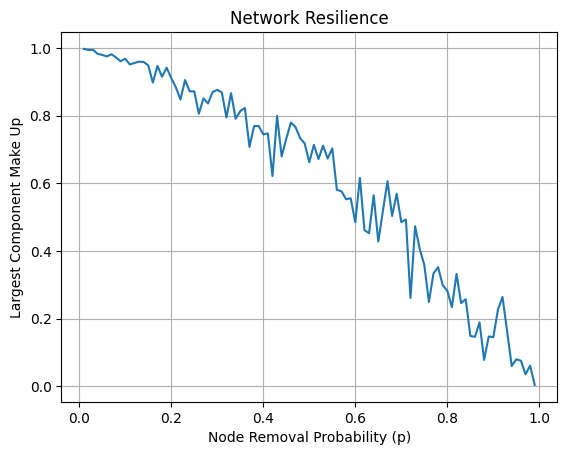

In [158]:
#(e)

p_vals = [i / 100 for i in range(1, 100)]
hashmap = []

for p in p_vals:
  G_3 = random_remove(G, p)
  hashmap.append(fraction_component(G_3))

#plt.figure(figsize=(10,6))
plt.plot(p_vals, hashmap)
plt.xlabel('Node Removal Probability (p)')
plt.ylabel('Largest Component Make Up')
plt.title('Network Resilience')
plt.grid(True)
plt.show()

Part (f):


---

So, I'm observing a clear downward trend in our network resilience graph, which obviously makes sense given the nature of removing more nodes increasing the larget-component makeup in some arbitrary new network. So, I've observed that at lower p-values, the given network is resilient, with the largest component retaining most of the remaining nodes in that network. Vice versa, more the nodes are removed, the network becomes more disparate and fragmented, leading to the observed decline in the size of the largest component in the network. Hence, when a significant percentage of the network's nodes fail, the largest connected component rapidly shrinks in size, indicating that the network has trouble staying connected.